In [2]:
#import des packages

import pandas as pd
import numpy as np

# preprocessing
from imblearn.under_sampling import RandomUnderSampler
from sklearn.preprocessing import normalize
from sklearn.model_selection import train_test_split

# import ML 
from sklearn.ensemble import RandomForestClassifier  
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV

#affichage visu
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline

#Metrics
from sklearn.metrics import classification_report, f1_score
from sklearn.metrics import plot_confusion_matrix, classification_report,confusion_matrix, ConfusionMatrixDisplay

Construction du Dataset

In [3]:
# Import des données 
 
    # Import des données des années 2020 et 2019

Usagers_19_20 = pd.concat([
    pd.read_csv('data/DataSource/usagers-2020.csv', sep = ';'), 
    pd.read_csv('data/DataSource/usagers-2019.csv', sep = ';')], 
    axis = 0)
Lieux_19_20 = pd.concat([
    pd.read_csv('data/DataSource/lieux-2020.csv', sep = ';'), 
    pd.read_csv('data/DataSource/lieux-2019.csv', sep = ';')], 
    axis = 0)
Caract_19_20 = pd.concat([
    pd.read_csv('data/DataSource/caracteristiques-2020.csv', sep = ';'), 
    pd.read_csv('data/DataSource/caracteristiques-2019.csv', sep = ';')],
    axis = 0)
Vehic_19_20 = pd.concat([
    pd.read_csv('data/DataSource/vehicules-2020.csv', sep = ';'), 
    pd.read_csv('data/DataSource/vehicules-2019.csv', sep = ';')], 
    axis = 0)

    # Import des données des années 2018,2017 et 2016

Usagers_16_18 = pd.concat([
    pd.read_csv('data/DataSource/usagers-2016.csv', sep = ','), 
    pd.read_csv('data/DataSource/usagers-2017.csv', sep = ','), 
    pd.read_csv('data/DataSource/usagers-2018.csv', sep = ',')], 
    axis = 0)
Lieux_16_18 = pd.concat([
    pd.read_csv('data/DataSource/lieux_2016.csv', sep = ',', low_memory=False), 
    pd.read_csv('data/DataSource/lieux-2017.csv', sep = ',', low_memory=False), 
    pd.read_csv('data/DataSource/lieux-2018.csv', sep = ',', low_memory=False)],
     axis = 0)
Caract_16_18 = pd.concat([
    pd.read_csv('data/DataSource/caracteristiques-2016.csv', sep = ',', encoding="ISO-8859-1"),
     pd.read_csv('data/DataSource/caracteristiques-2017.csv', sep = ',', encoding="ISO-8859-1"),
     pd.read_csv('data/DataSource/caracteristiques-2018.csv', sep = ',', encoding="ISO-8859-1")],
     axis = 0)
Vehic_16_18 = pd.concat([
    pd.read_csv('data/DataSource/vehicules-2016.csv', sep = ','), 
    pd.read_csv('data/DataSource/vehicules-2017.csv', sep = ','), 
    pd.read_csv('data/DataSource/vehicules-2018.csv', sep = ',')], 
    axis = 0)

In [4]:
#Création d'un dataset unique représentant les données agrégées sur un periode de 5 ans 
#######################################################################################  

    #les donnée de 2019/2020 ne sont pas renseignées de la même façon que les donnée des année précédantes
    #Dans le but de créer un dataset complet nous devons ici uniformiser les données des 5 derniere années


    #---------------------------------------------------------
    #uniformisation et fusion des données pour chaque fichiers
    #---------------------------------------------------------

        # Fichiers Caractéristiques
Caract_19_20['hrmn'] = (Caract_19_20['hrmn'].astype(str).str[0:2] + Caract_19_20['hrmn'].astype(str).str[3:5]).astype(int)
Caract_19_20['dep'] = Caract_19_20['dep'].replace(['2A','2B'],[201,202])
Caract_19_20["com"] = (Caract_19_20['dep'].astype(str) + Caract_19_20['com'].astype(str).str[2:]).astype(int)
Caract_16_18 = Caract_16_18.drop(['gps'], axis=1)
Caract_16_18 = Caract_16_18[['Num_Acc', 'jour', 'mois', 'an', 'hrmn', 'lum', 'dep','com', 'agg','int', 'atm', 'col', 'adr', 'lat', 'long']]
Caract_16_18["an"] = Caract_16_18["an"]+2000
Caract_16_18['dep'] = Caract_16_18['dep'].replace(["2A","2B"],[201,202])
Caract_16_18["com"] = Caract_16_18['dep']* 100 + Caract_16_18["com"]
Caract_16_18['dep'] = (Caract_16_18['dep'].astype(float)/10).astype(int)
Caract_16_18['col'] = (Caract_16_18['col'].fillna(-1)).astype(int)
Caract_16_18['atm'] = (Caract_16_18['atm'].fillna(-1)).astype(int)
            # Concaténation 
Caract_16_20 = pd.concat([Caract_16_18, Caract_19_20], axis = 0)


        # Fichier Lieux
Lieux_19_20 = Lieux_19_20.drop(['vma'], axis=1)   
Lieux_16_18 = Lieux_16_18.drop(['env1'], axis=1)
Lieux_16_18 = Lieux_16_18[['Num_Acc', 'catr', 'voie', 'v1', 'v2', 'circ', 'nbv', 'vosp', 'prof','pr', 'pr1', 'plan', 'lartpc', 'larrout', 'surf', 'infra', 'situ']]
Lieux_16_18['circ'] = (Lieux_16_18['circ'].fillna(-1)).astype(int)
Lieux_16_18['vosp'] = (Lieux_16_18['vosp'].fillna(-1)).astype(int)
Lieux_16_18['prof'] = (Lieux_16_18['prof'].fillna(-1)).astype(int)
Lieux_16_18['plan'] = (Lieux_16_18['plan'].fillna(-1)).astype(int)
Lieux_16_18['surf'] = (Lieux_16_18['surf'].fillna(-1)).astype(int)
Lieux_16_18['infra'] = (Lieux_16_18['infra'].fillna(-1)).astype(int)
Lieux_16_18['situ'] = (Lieux_16_18['situ'].fillna(-1)).astype(int)
Lieux_16_18['pr'] = Lieux_16_18['pr'].fillna(-1).astype(int)
Lieux_16_18['pr1'] = Lieux_16_18['pr1'].fillna(-1).astype(int)
            #Concaténation 
Lieux_16_20 = pd.concat([Lieux_16_18, Lieux_19_20], axis = 0)


        # Fichier Vehicule
Vehic_19_20 = Vehic_19_20.drop(['occutc','motor', 'id_vehicule' ], axis=1) 
Vehic_16_18 = Vehic_16_18[['Num_Acc', 'num_veh', 'senc', 'catv', 'obs', 'obsm','choc', 'manv']]
Vehic_16_18['senc'] = (Vehic_16_18['senc'].fillna(-1)).astype(int)
Vehic_16_18['obs'] = (Vehic_16_18['obs'].fillna(-1)).astype(int)
Vehic_16_18['obsm'] = (Vehic_16_18['obsm'].fillna(-1)).astype(int)
Vehic_16_18['choc'] = (Vehic_16_18['choc'].fillna(-1)).astype(int)
Vehic_16_18['manv'] = (Vehic_16_18['manv'].fillna(-1)).astype(int)  
            #Concaténation 
Vehic_16_20 = pd.concat([Vehic_16_18, Vehic_19_20], axis = 0)

        # Fichier Usager
Usagers_19_20['secu'] = Usagers_19_20['secu1']
Usagers_19_20 = Usagers_19_20.drop(['id_vehicule', 'secu1','secu2','secu3'  ], axis=1)
Usagers_16_18 = Usagers_16_18[['Num_Acc', 'num_veh', 'place', 'catu', 'grav', 'sexe', 'an_nais', 'trajet', 'locp', 'actp', 'etatp', 'secu']]
Usagers_16_18['etatp'] = (Usagers_16_18['etatp'].fillna(-1)).astype(int)
Usagers_16_18['trajet'] = (Usagers_16_18['trajet'].fillna(-1)).astype(int) 
Usagers_16_18['locp'] = (Usagers_16_18['locp'].fillna(-1)).astype(int)
Usagers_16_18['actp'] = (Usagers_16_18['actp'].fillna(-1)).astype(int)

    # Cas particulier Secu 
        # avant 01/2019 la sécu etait renseignée sur 2 chiffres 1er: présence de l'équipement, 2eme utilisation de l'équipement 
        # apres 01/2019 la secu est sur un seul caractère représentant la présence et l'utilisation de l'équipement.

def ConvSecu(i):
    use = i/10%1*10
    if use == 2:
        x = 0        
    else:
        if use == 3:
            x = 9
        else:
            x = i//10
    return x


Usagers_16_18['secu'] = (Usagers_16_18['secu'].fillna(-1)).astype(int).apply(ConvSecu)
            #Concaténation 
Usagers_16_20 = pd.concat([Usagers_16_18, Usagers_19_20], axis = 0)



    #--------------------------------------------
    # Merge des 4 fichiers = dataset Unique 5 ans
    #--------------------------------------------

All_Data = Usagers_16_20.merge( Vehic_16_20, on=['Num_Acc', 'num_veh']).merge(Lieux_16_20, on=['Num_Acc']).merge(Caract_16_20, on=['Num_Acc'])




    #---------------------------------------
    # traitement des valeurs non renseignées 
    #---------------------------------------
    
        #Dans le dataset complet nous avons différentes valeurs représentant les données non renseignées (NaN, 0, et/ou -1)
        #Ici nous allons unfiformiser ces données :
        
            #remplacement des données non-renseignées par NaN ( valeur -1 = non renseignée)
All_Data = All_Data.replace([-1],[np.nan])  

            # Dans la feature "trajet" la valeur 0 = non renseigné
All_Data["trajet"] = All_Data["trajet"].replace([0],[np.nan])

            # Dans les features "circ","plan",'surf', 'int' et "Prof" présence de la valeur 0 ne correspondant à aucune catégorie...remplacement par np.Nan
All_Data["circ"] = All_Data["circ"].replace([0],[np.nan])
All_Data["prof"] = All_Data["prof"].replace([0],[np.nan])
All_Data["plan"] = All_Data["plan"].replace([0],[np.nan])
All_Data["surf"] = All_Data["surf"].replace([0],[np.nan])
All_Data["int"] = All_Data["int"].replace([0],[np.nan])




In [6]:
All_Data

,Num_Acc,num_veh,place,catu,grav,sexe,an_nais,trajet,locp,actp,...,lum,dep,com,agg,int,atm,col,adr,lat,long
0,201600000001,B02,1.0,1,1,2,1983.0,NaN,0.0,0,...,1.0,59,59005,2,1.0,8.0,3.0,"46, rue Sonneville",0.0,0.0
1,201600000001,A01,1.0,1,3,1,2001.0,9.0,0.0,0,...,1.0,59,59005,2,1.0,8.0,3.0,"46, rue Sonneville",0.0,0.0
2,201600000002,A01,1.0,1,3,1,1960.0,5.0,0.0,0,...,1.0,59,59005,2,6.0,1.0,6.0,1a rue du cimetière,0.0,0.0
3,201600000002,A01,2.0,2,3,1,2000.0,NaN,0.0,0,...,1.0,59,59005,2,6.0,1.0,6.0,1a rue du cimetière,0.0,0.0
4,201600000002,A01,3.0,2,3,2,1962.0,NaN,0.0,0,...,1.0,59,59005,2,6.0,1.0,6.0,1a rue du cimetière,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
638007,201900058837,C01,1.0,1,4,2,1988.0,1.0,NaN,-1,...,1.0,67,67482,1,1.0,8.0,4.0,Autoroute A.35,"48,5769000","7,7269000"
638008,201900058838,A01,1.0,1,4,1,1998.0,9.0,NaN,-1,...,4.0,94,94021,1,1.0,1.0,6.0,AUTOROUTE A6A,"48,7717000","2,3457600"
638009,201900058839,A01,1.0,1,3,1,1979.0,NaN,NaN,-1,...,1.0,78,78640,1,1.0,1.0,7.0,A86 EXT,"48,7772890","2,2237590"
638010,201900058840,B01,1.0,1,4,1,1974.0,NaN,NaN,0,...,3.0,92,92047,1,1.0,1.0,2.0,A13,"48,8351236","2,1751101"


Exploration de données et  Visualisation 

In [5]:
All_Data_Visu = All_Data.copy()
All_Data_Visu["grav"] = All_Data_Visu["grav"].replace([1,2,3,4],["Indemne","Tué","Blessé grave","Blessé léger"])
All_Data_Visu["sexe"] = All_Data_Visu["sexe"].replace([1,2],["Homme","Femme"])
All_Data_Visu["mois"] = All_Data_Visu["mois"].replace([1,2,3,4,5,6,7,8,9,10,11,12],["Jan","Fev","Mar","Avr","Mai","Juin","Juil","Aout","Sep","Oct","Nov", "Dec"])
All_Data_Visu['catu'] = All_Data_Visu['catu'].replace([1, 2, 3], ["Conducteur","Passager", "Piéton"])

In [79]:
# Nombre d'accident de la route par année 

fig1 =px.histogram(Caract_16_20, x="an", color = "an",
        labels ={
                "an" : "Année",
                }, 
    opacity= 0.75,
    width=700, height=500,
    title='Nombre d\'accident de la route par année en France',
    template = "simple_white" ) 

fig1.add_annotation(
    text="Effet Covid", x="2020", y=48000, arrowhead=1, showarrow=True,
)
fig1.add_shape( 
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=56900, y1=56900, yref="y"
)


fig1.show()
# on observe une net diminution du nombre d'accident de la route en 2020 --> effet Covid


In [110]:
# Sunburst de la gravité des accidents en fonction du type d'usager 
fig11 = px.sunburst(All_Data_Visu, path =["grav"] , template = "simple_white",
                    title = "Répartition de la gravité des accidents")
fig11.update_traces(textinfo="label+percent parent")
fig11.update_layout(
    autosize=False,
    height=500,
    width=500
)
fig11.show()

In [101]:

# Répartition des Accident en fonction de la gravité et du sexe


fig2 = px.histogram(All_Data_Visu, x="grav", color = "sexe",  
        labels ={
                "grav" : "Gravité",
                "sexe": "Sexe"
                },
        width=600, height=400,

        title = "Répartition des accidents en fonction de la gravité et du sexe",
        category_orders={ # replaces default order by column name
                "sexe": ["Homme", "Femme"]
            },
        template = "simple_white"        
     )
fig2.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})
fig2.show()

In [102]:
#Répartition des accidents par mois et par gravité


fig3 = px.histogram(All_Data_Visu, x="mois",color = "grav",
        labels ={
                "mois" : "Mois",
                "grav": "Gravité"
                },        
        width=900, height=500,
        category_orders={ # replaces default order by column name
            "mois": ["Jan","Fev","Mar","Avr","Mai","Juin","Juil","Aout","Sep","Oct","Nov", "Dec"],
            "grav": ["Indemne","Blessé léger","Blessé grave","Tué"]
                },
        title = "Répartition des accidents par mois et par gravité",
        template = "simple_white",       
        opacity= 0.75 )
fig3.show()

In [33]:
#Route les plus meurtrière 
All_Data_Visu["catr"] = All_Data_Visu["catr"].replace([1,2,3,4,5,6,7,8,9],["Autoroute","Route nationale","Route Départementale","Voie Communales","Autre","Autre","Autre","Autre","Autre"])
fig4 = px.histogram(All_Data_Visu[All_Data_Visu['grav'] == "Tué"], x="catr",color = "grav",
        labels ={
                "catr" : "Catégorie Route",
                "grav": "Gravité"
                },
                title = "Total du nombre de tué par type de route",
        template = "simple_white", 
            
        opacity= 0.75 )
fig4.show()

In [20]:
# Sunburst de la gravité des accidents en fonction du type d'usager 
fig = px.sunburst(All_Data_Visu, path =["catu", "grav"] , template = "simple_white", title = "Répartition de la gravité des accidents par type d'usager",)
fig.update_traces(textinfo="label+percent parent")
fig.update_layout(
    autosize=False,
    height=600,
    width=600
)
fig.show()

In [34]:
# Gravité des accident par catégorie d'age

All_Data_Visu['catage'] = All_Data_Visu['an'] - All_Data_Visu['an_nais']
All_Data_Visu['catage'] = pd.cut(All_Data_Visu['catage'], bins = [0,18,30,45,60,110], labels =["0-18 ans","18-30 ans","30-45 ans","45-60 ans","+ 60 ans"])
All_Data_Visu = All_Data_Visu.apply(lambda x: x.fillna(x.value_counts().index[0]))


fig6 = px.histogram(All_Data_Visu, x="catage",color = "grav",
        labels ={
                "catage" : "Catégorie d'age",
                "grav": "Gravité"
                },
                title = "Gravité des accidents par catégorie d'âge",
        template = "simple_white", 
        width=900, height=500,      
        opacity= 0.75,
        category_orders={ # replaces default order by column name
            "catage": ["0-18 ans","18-30 ans","30-45 ans","45-60 ans","+ 60 ans"],
            "grav": ["Indemne","Blessé léger","Blessé grave","Tué"]
                }, )
fig6.show()

Machine Learning

In [10]:
# Préparation du dataset pour ML 
#################################

        #------------------------------
        #Gestion des valeurs manquantes
        #------------------------------ 

                #classement des features par pourcentage de valeur manquante

def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return pd.concat([total, percent], axis=1, keys=['Total NaN Values', 'Percentage of NaN Values'])

ms_data = missing_data(All_Data).head(20)
ms_data.head(20)

,Total NaN Values,Percentage of NaN Values
v2,604465,94.741948
v1,441181,69.149326
lartpc,348137,54.565902
etatp,274082,42.958753
larrout,241059,37.782832
pr1,181698,28.478775
pr,180530,28.295706
trajet,160224,25.113007
locp,155885,24.432926
voie,117184,18.367053


In [24]:
fig_ms = px.bar(ms_data["Percentage of NaN Values"], template = "simple_white" )
fig_ms.add_shape( 
    type="line", line_color="salmon", line_width=3, opacity=1, line_dash="dot",
    x0=0, x1=1, xref="paper", y0=6, y1=6, yref="y"
)
fig_ms.add_annotation(
    text="Seuil 6%", x="surf", y=7, arrowhead=1, showarrow=True,
)


In [115]:

        
                # supression des features qui ont plus de 6% de NaN + adr qui ne sera pas utile par la suite 

Data_clean= All_Data.drop(["v2","v1","lartpc", "etatp", "larrout", "pr1", "pr",  "trajet", "locp", "voie", "actp", "lat", "long", "adr"], axis=1)

                # pour les autres features remplacement des NaN par la valeur la plus représentée 

Data_clean = Data_clean.apply(lambda x: x.fillna(x.value_counts().index[0]))
Data_clean[Data_clean.columns[2:]] = Data_clean[Data_clean.columns[2:]].astype(int)

        #---------------------------------------
        #simplification des features du dataset
        #--------------------------------------- 

                # Création d'une feature catégorie d'age

Data_clean['catage'] = Data_clean['an'] - Data_clean['an_nais']
Data_clean['catage'] = pd.cut(Data_clean['catage'], bins = [0,18,30,45,60,110], labels =[1,2,3,4,5])
Data_clean = Data_clean.apply(lambda x: x.fillna(x.value_counts().index[0]))

                # Création d'une feature WE (semaine = 1 WE = 2)
import calendar
Data_clean["WE"] =  Data_clean["jour"].astype(str) + " " + Data_clean["mois"].astype(str) + " " + Data_clean["an"].astype(str)

def findDay(date):
    day, month, year = (int(i) for i in date.split(' '))   
    dayNumber = calendar.weekday(year, month, day)
    days =[1, 1, 1, 1, 1, 2, 2]
    return (days[dayNumber])

Data_clean["WE"] = Data_clean["WE"].apply(findDay)

                #simplification de la catégorie des vehicule
                        
Data_clean["catv"] = Data_clean["catv"].replace([80],1 ) #cat 1 velo (1+80)                           
Data_clean["catv"] = Data_clean["catv"].replace([33,30,31,41,42,43,32,34,35,36],2) #cat 2 deux roues à moteur +quad                          
Data_clean["catv"] = Data_clean["catv"].replace([7,3,10],3 ) #cat 3 voiture/voiturette/vu                          
Data_clean["catv"] = Data_clean["catv"].replace([13,14,15],4)#cat 4 Poids Lourds                           
Data_clean["catv"] = Data_clean["catv"].replace([37,38,39,40],5)#cat 5 Transport collectif                          
Data_clean["catv"] = Data_clean["catv"].replace([16,17,20,21],6 )#cat 6 Engin agricole                         
Data_clean["catv"] = Data_clean["catv"].replace([99,50,60,0],7)#cat 7 Autre: EDP,indeterminable


                #simplification de la catégorie manoeuvre
                             
Data_clean["catv"] = Data_clean["catv"].replace([12],11)# regroupement changement de fille                             
Data_clean["catv"] = Data_clean["catv"].replace([14],13)# regroupement deporté                            
Data_clean["catv"] = Data_clean["catv"].replace([16],15)# regroupement tournant                          
Data_clean["catv"] = Data_clean["catv"].replace([8],7)# regroupement Dans le couloir bus,                           
Data_clean["catv"] = Data_clean["catv"].replace([18],17)# regroupement Dépassement




                #supression des informations redondantes ou inutiles 
Data_Model= Data_clean.drop(["com", "hrmn", "senc",'an_nais', 'an', 'jour', 'Num_Acc','num_veh', 'dep' ], axis=1)
Data_Model = Data_Model.astype(object)
Data_Model.head()

,place,catu,grav,sexe,secu,catv,obs,obsm,choc,manv,...,infra,situ,mois,lum,agg,int,atm,col,catage,WE
0,1,1,1,2,1,3,0,0,1,1,...,0,1,2,1,2,1,8,3,3,1
1,1,1,3,1,2,2,0,0,7,15,...,0,1,2,1,2,1,8,3,1,1
2,1,1,3,1,1,3,6,0,1,1,...,0,1,3,1,2,6,1,6,4,1
3,2,2,3,1,1,3,6,0,1,1,...,0,1,3,1,2,6,1,6,1,1
4,3,2,3,2,1,3,6,0,1,1,...,0,1,3,1,2,6,1,6,4,1


ML


In [85]:
#Création de 3 DataSet 

    # 1- 4 classes à prédire (0 = 'Indemne', 1 = 'Tué', 2 = 'Blessé hospitalisé', 3 = 'Blessé léger')
data_4C = Data_Model.copy()
data_4C['grav'] = data_4C['grav'].replace([1,2,3,4],[0,1,2,3]).astype(int)
y_4c = data_4C.grav
x_4c = data_4C.drop(columns='grav')

    # 2- 3 classes à prédire (0 = 'Indemne'/'Blessé léger', 1 = 'Tué', 2 = 'Blessé hospitalisé)
data_3C = Data_Model.copy()    
data_3C['grav'] = data_3C['grav'].replace([1,2,3,4],[0,1,2,0]).astype(int)
y_3c = data_3C.grav
x_3c = data_3C.drop(columns='grav')

    # 5- 2 classes à prédire (0 = 'Indemne'/blessé leger, 1 = bléssé grave/'Tué')
data_2C = Data_Model.copy()   
data_2C['grav'] = data_2C['grav'].replace([1,2,3,4],[0,1,1,0]).astype(int)
y_2c = data_2C.grav
x_2c = data_2C.drop(columns='grav')


In [87]:
# fonction : rééquilibrage des données par undersampling
def underSamping(X, y):
    rus = RandomUnderSampler(random_state=42, replacement=True)
    X_rus, y_rus = rus.fit_resample(X, y)
    return X_rus, y_rus

In [88]:
# fonction : normalisation des données 

def splitting(X, y):
    # hot encoding of the features
    X = pd.get_dummies(X)
    # Splitting the data for training and test purpose
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= .2)
    return X_train, X_test, y_train, y_test

In [89]:
# fonction : entrainement des algo choisis, resultats des algo ( classif report + matrice de confusion) et graph comparatif des résultats


def Resultat_model():

    score_results = [] # stock les résultat pour comparaison des modèle

    #RandomForest
    model_rf = RandomForestClassifier().fit(X_train, y_train) # entrainement du modèle
    predictions_test = model_rf.predict(X_test)# calcul des prédictions
    model_rf_score = f1_score(y_test, predictions_test, average = 'macro')# calulc accuracy 
    score_results.append(f1_score(y_test, predictions_test, average = 'macro')*100) #F1-score average macro
    print("RandomForest : \n --------------------------------------------------------")
    print('RandomForest: Macro average f1 score  : {:04.3f}'.format(
        f1_score(y_test, predictions_test, average = 'macro')) +
            "\n --------------------------------------------------------"
        )
    print(classification_report(y_test, predictions_test, digits=3, zero_division = 1)),# classification report 
    cm = confusion_matrix(y_test, predictions_test, labels=model_rf.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot(cmap='Reds', values_format='d',xticks_rotation= 'vertical')
    plt.show()# matrice de confusion
    
    
    #GradienBoosting
    model_xgb = GradientBoostingClassifier().fit(X_train, y_train)
    predictions_test = model_xgb.predict(X_test)
    model_xgb_score = model_xgb.score(X_test, y_test)
    score_results.append(f1_score(y_test, predictions_test, average = 'macro')*100)
    print("GradientBoosting : \n --------------------------------------------------------")
    print('GradientBoosting: Macro average f1 score  : {:04.3f}'.format(
        f1_score(y_test, predictions_test, average = 'macro')) +
            "\n --------------------------------------------------------"
        )
    print(classification_report(y_test, predictions_test, digits=3, zero_division = 1)),
    cm = confusion_matrix(y_test, predictions_test, labels=model_xgb.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot(cmap='Reds', values_format='d',xticks_rotation= 'vertical')
    plt.show()
    
    #KNeighbors
    model_knn = KNeighborsClassifier().fit(X_train, y_train)
    predictions_test = model_knn.predict(X_test)
    model_knn_score = model_knn.score(X_test, y_test)
    score_results.append(f1_score(y_test, predictions_test, average = 'macro')*100)
    print("KNeighbors : \n --------------------------------------------------------")
    print('KNeighbors: Macro average f1 score  : {:04.3f}'.format(
        f1_score(y_test, predictions_test, average = 'macro')) +
            "\n --------------------------------------------------------"
        )
    print(classification_report(y_test, predictions_test, digits=3, zero_division = 1)),
    cm = confusion_matrix(y_test, predictions_test, labels=model_knn.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot(cmap='Reds', values_format='d',xticks_rotation= 'vertical')
    plt.show()
    
    #DesicionTree
    model_dt = DecisionTreeClassifier().fit(X_train, y_train)
    predictions_test = model_dt.predict(X_test)
    model_dt_score = model_dt.score(X_test, y_test)
    score_results.append(f1_score(y_test, predictions_test, average = 'macro')*100)
    print("DecisionTree : \n --------------------------------------------------------")
    print('DecisionTree: Macro average f1 score  : {:04.3f}'.format(
        f1_score(y_test, predictions_test, average = 'macro')) +
            "\n --------------------------------------------------------"
        )
    print(classification_report(y_test, predictions_test, digits=3, zero_division = 1)),
    cm = confusion_matrix(y_test, predictions_test, labels=model_dt.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
    disp.plot(cmap='Reds', values_format='d',xticks_rotation= 'vertical')
    plt.show()



     #Graph comparaison des résultats
         
    cv_frame = pd.DataFrame(
        {
            "Algorithms":[
                        "RandomForest",
                        "GradientBoosting",
                        "KNeighbors",
                        "DecisionTree",                
                        ],
            "CrossValMeans":score_results
        })

    cv_plot = sns.barplot(x="CrossValMeans",y="Algorithms", data = cv_frame,
                    palette="Paired", orient = "h")

    for p in cv_plot.patches:
        _x = p.get_x() + p.get_width() - 8
        _y = p.get_y() + p.get_height() - (p.get_height()*0.5)
        value = '{:.2f}%'.format(p.get_width())
        cv_plot.text(_x, _y, value, ha="left")

    cv_plot.set_xlabel("F1-score")
    cv_plot = cv_plot.set_title("Algorithms Scores Graph")

c:\Users\girar\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\algorithms.py:798: FutureWarning:

In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)



RandomForest : 
 --------------------------------------------------------
RandomForest: Macro average f1 score  : 0.573
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.662     0.776     0.714      3264
           1      0.591     0.650     0.619      3431
           2      0.497     0.407     0.448      3469
           3      0.534     0.490     0.511      3378

    accuracy                          0.578     13542
   macro avg      0.571     0.581     0.573     13542
weighted avg      0.570     0.578     0.571     13542



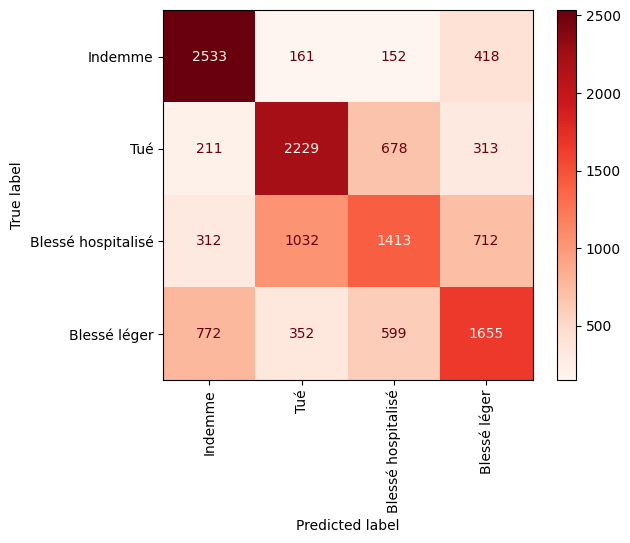

GradientBoosting : 
 --------------------------------------------------------
GradientBoosting: Macro average f1 score  : 0.541
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.628     0.796     0.702      3264
           1      0.565     0.644     0.602      3431
           2      0.442     0.315     0.368      3469
           3      0.519     0.466     0.491      3378

    accuracy                          0.552     13542
   macro avg      0.539     0.555     0.541     13542
weighted avg      0.537     0.552     0.538     13542



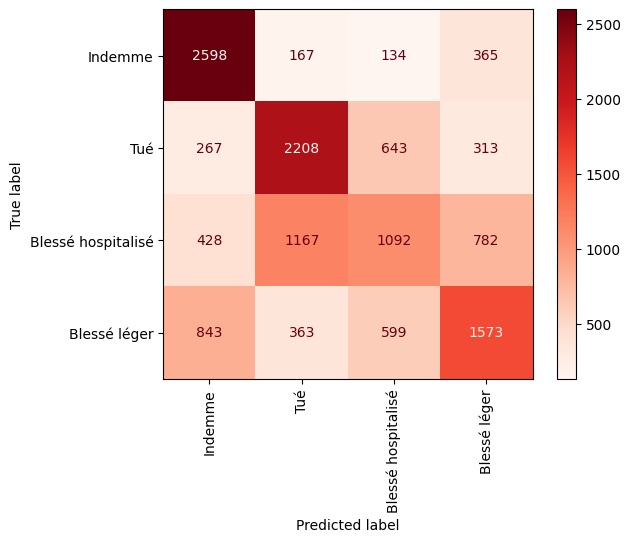

KNeighbors : 
 --------------------------------------------------------
KNeighbors: Macro average f1 score  : 0.500
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.594     0.730     0.655      3264
           1      0.512     0.601     0.553      3431
           2      0.408     0.380     0.393      3469
           3      0.495     0.333     0.398      3378

    accuracy                          0.509     13542
   macro avg      0.502     0.511     0.500     13542
weighted avg      0.501     0.509     0.498     13542



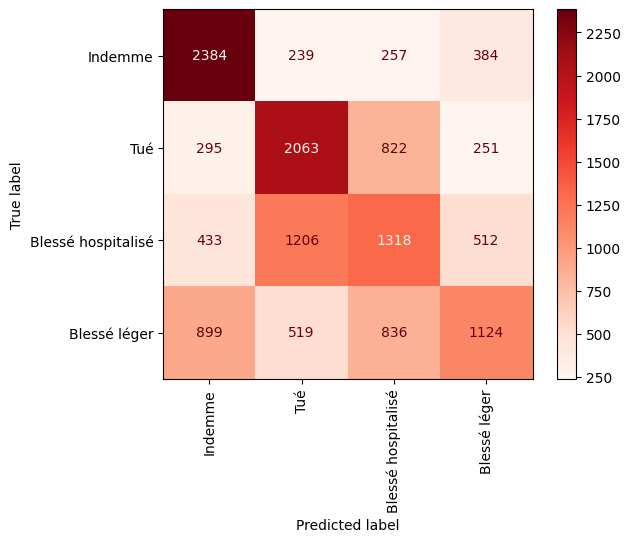

DecisionTree : 
 --------------------------------------------------------
DecisionTree: Macro average f1 score  : 0.480
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.605     0.613     0.609      3264
           1      0.507     0.502     0.505      3431
           2      0.396     0.400     0.398      3469
           3      0.412     0.407     0.409      3378

    accuracy                          0.479     13542
   macro avg      0.480     0.481     0.480     13542
weighted avg      0.479     0.479     0.479     13542



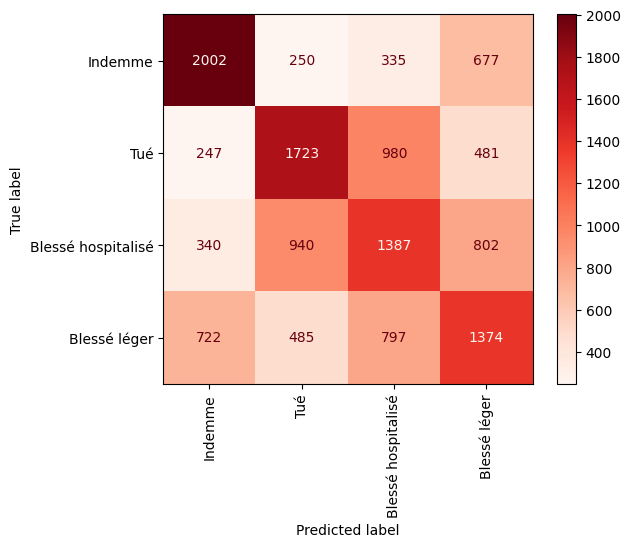

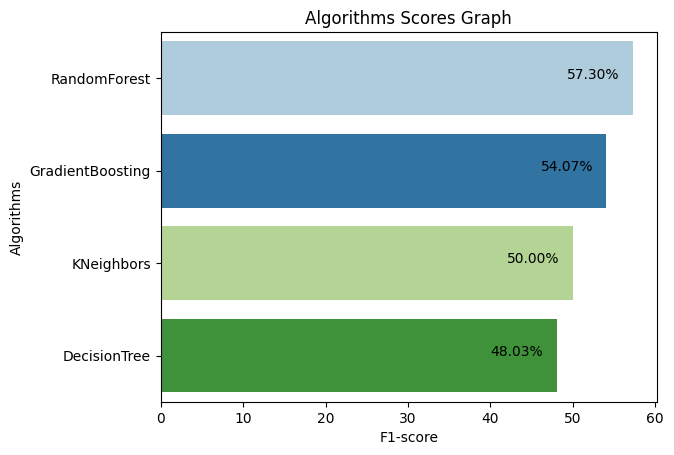

In [90]:
# 1- 4 classes à prédire
    #définition des labels des classes à prédire
labels = ['Indemme', 'Tué', 'Blessé hospitalisé', 'Blessé léger']

    # rééquilibrage des classes ()
X, y = underSamping(x_4c, y_4c)

    #séparation en jeu d'entrainement et de test 
X_train, X_test, y_train, y_test = splitting(X, y)

    #Entrainement et réultat des différent algorithme
Resultat_model()

c:\Users\girar\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\algorithms.py:798: FutureWarning:

In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)



RandomForest : 
 --------------------------------------------------------
RandomForest: Macro average f1 score  : 0.633
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.717     0.716     0.717      3361
           1      0.634     0.670     0.652      3428
           2      0.547     0.515     0.530      3368

    accuracy                          0.634     10157
   macro avg      0.632     0.634     0.633     10157
weighted avg      0.632     0.634     0.633     10157



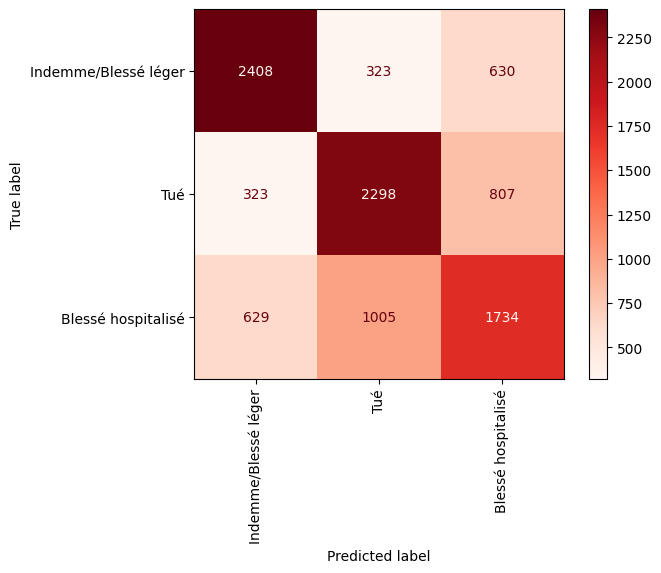

GradientBoosting : 
 --------------------------------------------------------
GradientBoosting: Macro average f1 score  : 0.602
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.701     0.669     0.685      3361
           1      0.599     0.647     0.622      3428
           2      0.508     0.490     0.499      3368

    accuracy                          0.602     10157
   macro avg      0.603     0.602     0.602     10157
weighted avg      0.603     0.602     0.602     10157



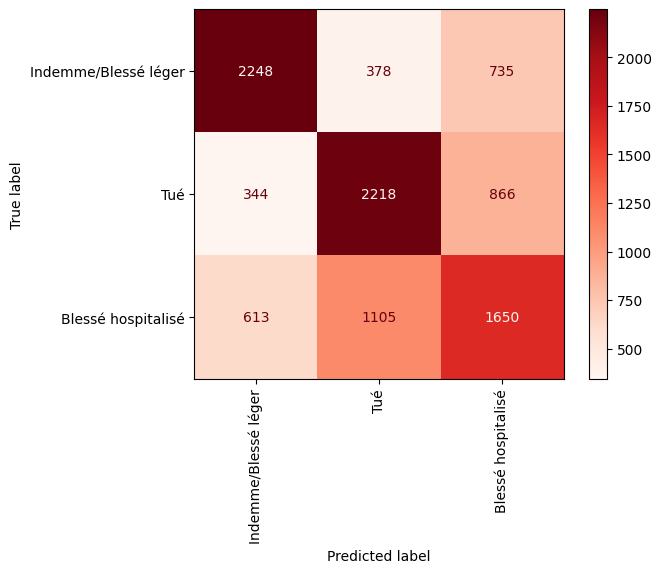

KNeighbors : 
 --------------------------------------------------------
KNeighbors: Macro average f1 score  : 0.554
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.616     0.681     0.647      3361
           1      0.565     0.606     0.585      3428
           2      0.477     0.391     0.430      3368

    accuracy                          0.560     10157
   macro avg      0.553     0.560     0.554     10157
weighted avg      0.553     0.560     0.554     10157



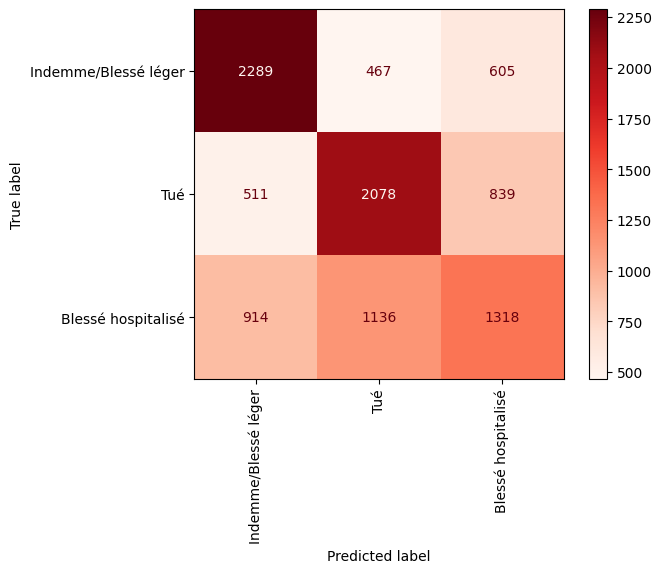

DecisionTree : 
 --------------------------------------------------------
DecisionTree: Macro average f1 score  : 0.539
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.618     0.606     0.612      3361
           1      0.553     0.533     0.543      3428
           2      0.451     0.476     0.463      3368

    accuracy                          0.538     10157
   macro avg      0.541     0.538     0.539     10157
weighted avg      0.541     0.538     0.539     10157



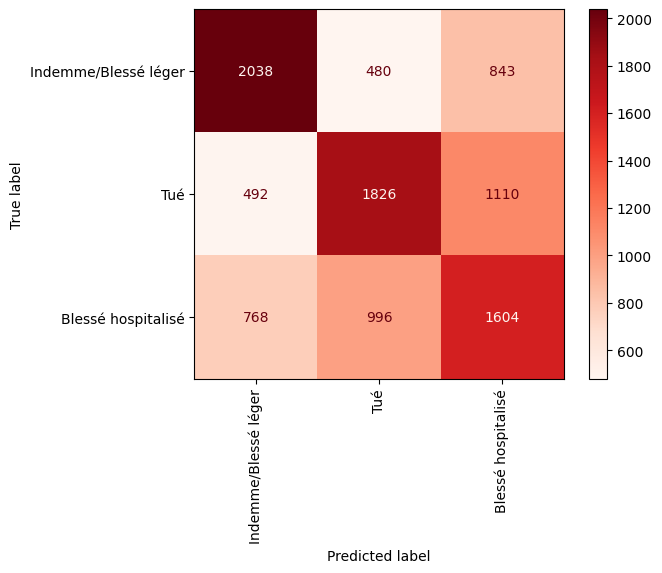

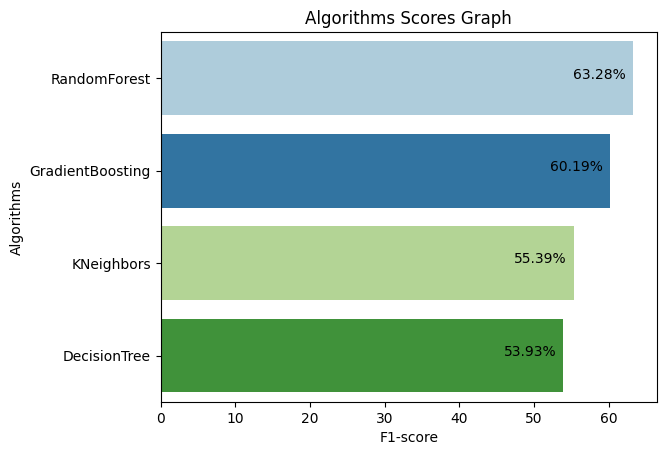

In [91]:
# 1- 3 classes à prédire
    #définition des labels des classes à prédire
labels = ['Indemme/Blessé léger', 'Tué', 'Blessé hospitalisé']

    # rééquilibrage des classes ()
X, y = underSamping(x_3c, y_3c)

    #séparation en jeu d'entrainement et de test 
X_train, X_test, y_train, y_test = splitting(X, y)

    #Entrainement et réultat des différent algorithme
Resultat_model()

c:\Users\girar\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\algorithms.py:798: FutureWarning:

In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)



RandomForest : 
 --------------------------------------------------------
RandomForest: Macro average f1 score  : 0.794
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.804     0.779     0.792     26901
           1      0.785     0.809     0.797     26747

    accuracy                          0.794     53648
   macro avg      0.795     0.794     0.794     53648
weighted avg      0.795     0.794     0.794     53648



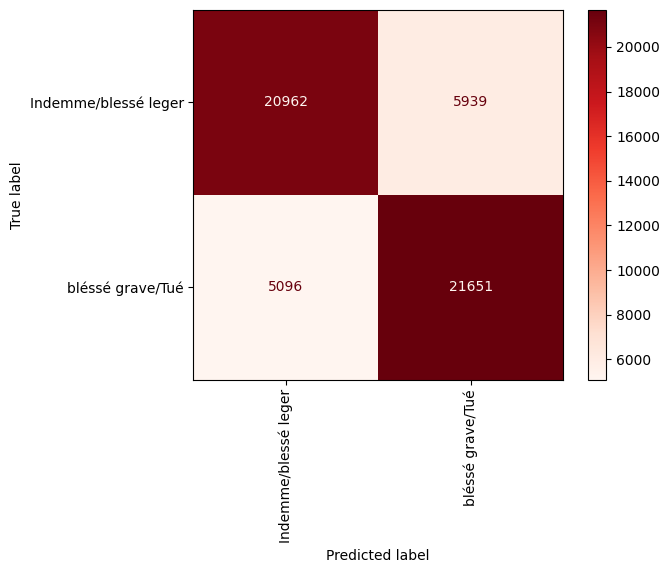

GradientBoosting : 
 --------------------------------------------------------
GradientBoosting: Macro average f1 score  : 0.757
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.785     0.711     0.746     26901
           1      0.734     0.804     0.768     26747

    accuracy                          0.757     53648
   macro avg      0.760     0.757     0.757     53648
weighted avg      0.760     0.757     0.757     53648



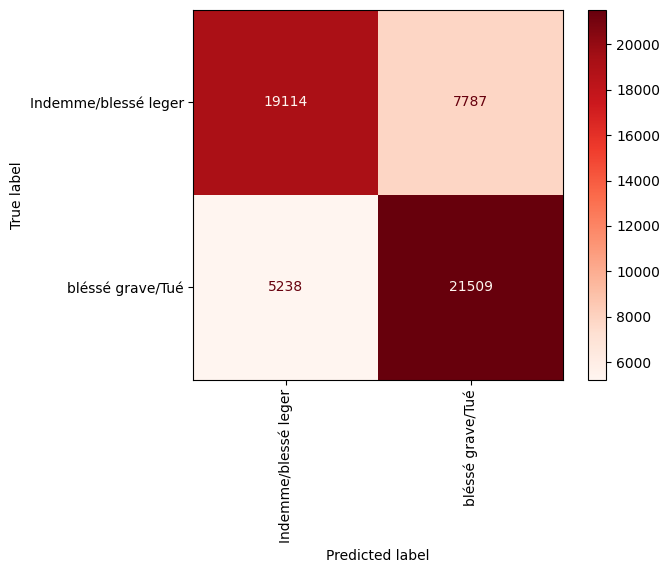

KNeighbors : 
 --------------------------------------------------------
KNeighbors: Macro average f1 score  : 0.742
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.751     0.727     0.739     26901
           1      0.734     0.757     0.745     26747

    accuracy                          0.742     53648
   macro avg      0.742     0.742     0.742     53648
weighted avg      0.742     0.742     0.742     53648



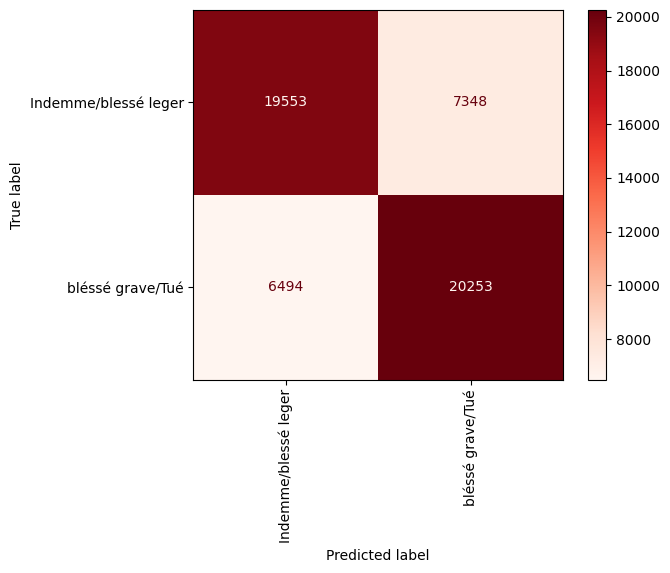

DecisionTree : 
 --------------------------------------------------------
DecisionTree: Macro average f1 score  : 0.724
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.717     0.743     0.730     26901
           1      0.732     0.706     0.719     26747

    accuracy                          0.724     53648
   macro avg      0.725     0.724     0.724     53648
weighted avg      0.725     0.724     0.724     53648



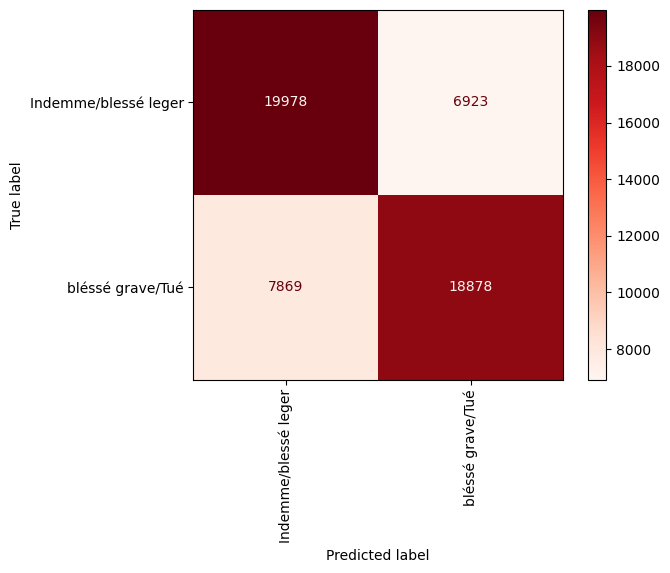

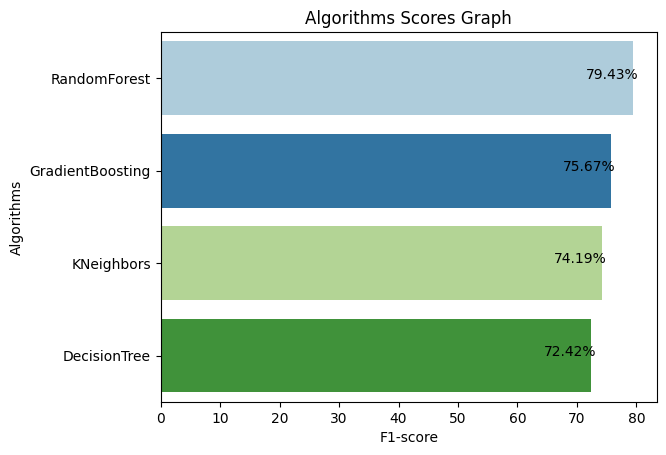

In [92]:
# 3- 2 classes à prédire
    #définition des labels des classes à prédire
labels =  ['Indemme/blessé leger', 'bléssé grave/Tué']

    # rééquilibrage des classes ()
X, y = underSamping(x_2c, y_2c)

    #séparation en jeu d'entrainement et de test 
X_train, X_test, y_train, y_test = splitting(X, y)

    #Entrainement et réultat des différent algorithme
Resultat_model()

In [93]:
# Dans les 3 Cas le RandomForest est l'alorithme qui obtient le meilleur score
# La prédiction sur 2 catégories est la prédiction qui est la plus précise (Average F1-score = 79.1%)

#######  /!\ traitement long ( 70 min ) #########
# Résultat ci-dessous  
# résultat {'max_depth': 40, 'max_features': 'auto', 'n_estimators': 600}
#Optimisation de l'algorithme sur le dataset 3 (2 classes à prédire)


X, y = underSamping(x_2c, y_2c)

X_train, X_test, y_train, y_test = splitting(X, y)

# Param a tester pour le grid search
param_grid = {'n_estimators': [400, 500, 600,],
                'max_features' : ['auto', 'sqrt'],
                'max_depth': [20, 30, 40,],
            }
##grid = GridSearchCV(estimator = RandomForestClassifier(), param_grid = param_grid, cv = 5, n_jobs=-1)
##grid.fit(X_train, y_train)

##grid.best_params_


#résultat {'max_depth': 40, 'max_features': 'auto', 'n_estimators': 600}


c:\Users\girar\AppData\Local\Programs\Python\Python310\lib\site-packages\pandas\core\algorithms.py:798: FutureWarning:

In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)



c:\Users\girar\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\ensemble\_forest.py:427: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.



RandomForest : 
 --------------------------------------------------------
RandomForest: Macro average f1 score  : 0.798
 --------------------------------------------------------
              precision    recall  f1-score   support

           0      0.817     0.772     0.794     27074
           1      0.780     0.824     0.801     26574

    accuracy                          0.798     53648
   macro avg      0.799     0.798     0.798     53648
weighted avg      0.799     0.798     0.798     53648



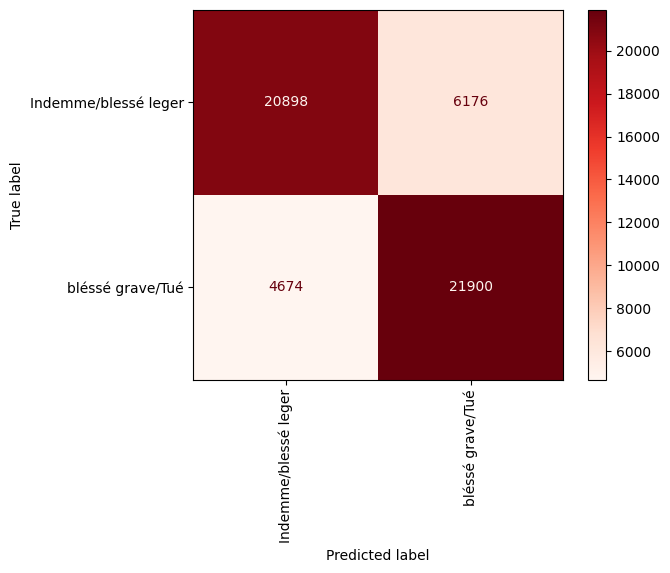

In [116]:
  #RandomForest
  
model_rf = RandomForestClassifier(max_depth= 40, max_features = 'auto', n_estimators= 600).fit(X_train, y_train) # entrainement du modèle
predictions_test = model_rf.predict(X_test)# calcul des prédictions
model_rf_score = f1_score(y_test, predictions_test, average = 'macro')# calulc accuracy 
print("RandomForest : \n --------------------------------------------------------")
print('RandomForest: Macro average f1 score  : {:04.3f}'.format(
    f1_score(y_test, predictions_test, average = 'macro')) +
        "\n --------------------------------------------------------"
    )
print(classification_report(y_test, predictions_test, digits=3, zero_division = 1)),# classification report 
cm = confusion_matrix(y_test, predictions_test, labels=model_rf.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
disp.plot(cmap='Reds', values_format='d',xticks_rotation= 'vertical')
plt.show()# matrice de confusion   